# Transposed GEM to UMAP

Giving UMAP a GEM that has samples as rows and genes as columns gives a network of samples, with edges determined by gene relationship.

If we give UMAP a GEM that has been transposed, can we expect a network of genes with edges determined by sample (sample conditions)?

In [210]:
import time
import os

import numpy as np
import pandas as pd
import xarray as xr
import umap

from datashader.layout import random_layout, circular_layout, forceatlas2_layout

import holoviews as hv
import holoviews.operation.datashader as hd

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
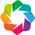

In [48]:
# Notebook specific imports.
hv.extension('bokeh')

### Input Data

In [49]:
qt_osativa_path = "/scidas/osativa_heat_drought/02-create_GEM/02-GEMmaker/output/GEMs/rice_heat_drought.GEM.FPKM.quantn.txt"
osativa_labels = "srx_sample_annots.txt"

In [214]:
os.stat(qt_osativa_path).st_size * 1e-6

258.930753

In [50]:
%%time
xdf = pd.read_csv(qt_osativa_path, sep='\t', index_col=0)

CPU times: user 5.68 s, sys: 408 ms, total: 6.09 s
Wall time: 6.1 s


In [51]:
%%time
ydf = pd.read_csv(osativa_labels, index_col=0)

CPU times: user 0 ns, sys: 7.39 ms, total: 7.39 ms
Wall time: 6.2 ms


In [198]:
ydf.head(2)

,Sample,Treatment,Time,Tissue,Genotype
SRX1424000,SRR2931106,HEAT,240,leaf,AZ
SRX1424164,SRR2931270,RECOV_DROUGHT,210,leaf,KP


In [52]:
print(xdf.shape)
print(ydf.shape)

(51402, 475)
(475, 5)


#### Subset Creation

In [99]:
x_col_sample = xdf.sample(100, axis=0).fillna(0)
x_col_sample.head(2)

,SRX1423934,SRX1423935,SRX1423936,SRX1423937,SRX1423938,SRX1423939,SRX1423940,SRX1423941,SRX1423942,SRX1423943,...,SRX1424399,SRX1424400,SRX1424401,SRX1424402,SRX1424403,SRX1424404,SRX1424405,SRX1424406,SRX1424407,SRX1424408
LOC_Os08g31260,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
LOC_Os02g48080,0.648534,0.159536,0.427257,0.0,0.568261,0.972747,0.518471,0.82433,0.952413,0.479474,...,0.153133,0.283228,0.002568,0.038945,0.52741,0.637593,0.452109,0.778309,0.070564,0.422214


In [100]:
x_col_sample.shape

(100, 475)

### Run Transposed UMAP Simplicial Set

There are issues with running the entire set directly. The KNN intitialization fails due to the large number of genes / features considered. Exploring on different gene samplings and timing the function should give an idea as to how this function scales in run time against features considered.

In [58]:
def time_function(function):
    """Wrap a function with a timer. Returns a tuple of
    the functions results, and the time elapsed in seconds."""
    def timed(*args, **kwargs):
        time_start = time.time()
        result = function(*args, **kwargs)
        time_end = time.time()
        return result, (time_end - time_start)
    return timed

# Create a timed version of the umap function of interest.
timed_fuzzy_set = time_function(umap.umap_.fuzzy_simplicial_set)

Create a series of subset, or sampling, sizes.

In [68]:
subsets = np.geomspace(100, 51402, num=25, dtype=np.int)
hv.Points(subsets, kdims=['Subsample index', 'Subsample Size']).opts(width=650, height=300)

:Points   [Subsample index,Subsample Size]

#### Test timed function

In [60]:
timed_fuzzy_set(
    X=x_col_sample,
    n_neighbors=15,
    random_state=np.random.RandomState(42),
    metric='euclidean',
)

(<100x100 sparse matrix of type '<class 'numpy.float64'>'
 	with 2268 stored elements in Compressed Sparse Row format>,
 1.518282175064087)

### Time Fuzzy Simplicial Set Generation

In [71]:
times = dict()
results = dict()
random_state = np.random.RandomState(42)


for idx, subset_size in enumerate(subsets):
    print(f"Working on subset {idx} of size {subset_size}.")
    result, run_time = timed_fuzzy_set(
        X=xdf.sample(subset_size, axis=0, random_state=random_state).fillna(0).values,
        n_neighbors=15,
        random_state=random_state,
        metric='euclidean'
    )
    times[subset_size] = run_time
    results[subset_size] = result
    print(f"Run {idx} of size {subset_size} complete. Time: {run_time:.2f} seconds.")

Working on subset 0 of size 100.
Run 0 of size 100 complete. Time: 1.30 seconds.
Working on subset 1 of size 129.
Run 1 of size 129 complete. Time: 1.56 seconds.
Working on subset 2 of size 168.
Run 2 of size 168 complete. Time: 1.35 seconds.
Working on subset 3 of size 218.
Run 3 of size 218 complete. Time: 1.57 seconds.
Working on subset 4 of size 283.
Run 4 of size 283 complete. Time: 1.45 seconds.
Working on subset 5 of size 367.
Run 5 of size 367 complete. Time: 1.72 seconds.
Working on subset 6 of size 476.
Run 6 of size 476 complete. Time: 1.62 seconds.
Working on subset 7 of size 617.
Run 7 of size 617 complete. Time: 2.10 seconds.
Working on subset 8 of size 801.
Run 8 of size 801 complete. Time: 3.27 seconds.
Working on subset 9 of size 1039.
Run 9 of size 1039 complete. Time: 4.09 seconds.
Working on subset 10 of size 1347.
Run 10 of size 1347 complete. Time: 5.66 seconds.
Working on subset 11 of size 1747.
Run 11 of size 1747 complete. Time: 7.73 seconds.
Working on subset 

Examine, and plot the (timing) results.

In [86]:
times_df = pd.DataFrame.from_dict(times, orient='index').reset_index()
times_df.columns = ['Sample Size', 'Time (s)']
times_df.tail(2)

,Sample Size,Time (s)
23,39629,416.107375
24,51402,588.525957


The loop seems to have supressed the error output.

In [90]:
tpoints = hv.Points(times_df)
tcurve  = hv.Curve(times_df)
tlayout = tpoints * tcurve
tlayout.opts(width=650, height=400)
tlayout.opts(hv.opts.Points(size=10))

:Overlay
   .Points.I :Points   [Sample Size,Time (s)]
   .Curve.I  :Curve   [Sample Size]   (Time (s))

### Build Edge-Lists

To be considered:
+ What cutoff is reasonable for drawing edges?
+ Ensure that sample information can be associated with each edge drawn?

---

First rebuild the indexes. (Done separate.)

In [158]:
def to_edge_list(size, fuzzy_graph):
    """Convert a sparse matrix to an edge list."""
    index = xdf.index.values[:size]
    fuzzy_df = pd.DataFrame(fuzzy_graph.todense())
    fuzzy_edges = pd.DataFrame(fuzzy_df.stack()).reset_index()
    fuzzy_edges.columns = ['source', 'target', 'weight']
    return fuzzy_edges

In [159]:
small_test = to_edge_list(100, results[100])
small_test.head(2)

,source,target,weight
0,0,0,0.000000
1,0,1,0.206996


In [160]:
st_nodes = pd.DataFrame(xdf.index.values[:100], columns=['Gene'])
st_nodes.head(2)

,Gene
0,LOC_Os01g01010
1,LOC_Os01g01019


In [185]:
def view(size, edge_list, threshold=.95, atlas_iterations=100):
    cutoff = edge_list['weight'].quantile(threshold)
    filtered = edge_list[edge_list['weight'] > cutoff]
    nodes = pd.DataFrame(xdf.index.values[:size], columns=['Gene'])
    atlas_layout = forceatlas2_layout(nodes, filtered, iterations=atlas_iterations)
    hv_nodes = hv.Nodes(atlas_layout, kdims=['x', 'y', 'index'])
    graph = hv.Graph((filtered, hv_nodes))
    node_opts = hv.opts.Graph(node_size=8, padding=0.1, width=800, 
                              edge_line_width=0.1,
                              height=600, xaxis=None, yaxis=None)
    return graph.opts(node_opts)

In [186]:
view(100, small_test)

:Graph   [source,target]   (weight)

In [188]:
result_list = list(results.items())

In [189]:
result_list[0]

(100, <100x100 sparse matrix of type '<class 'numpy.float64'>'
 	with 2060 stored elements in Compressed Sparse Row format>)

In [194]:
size, matrix = result_list[0]
view(size, to_edge_list(size, matrix))

:Graph   [source,target]   (weight)

In [195]:
size, matrix = result_list[1]
view(size, to_edge_list(size, matrix))

:Graph   [source,target]   (weight)

In [199]:
size, matrix = result_list[2]
hd.bundle_graph(view(size, to_edge_list(size, matrix)))

:Graph   [source,target]   (weight)

In [200]:
size, matrix = result_list[3]
hd.bundle_graph(view(size, to_edge_list(size, matrix)))

:Graph   [source,target]   (weight)

In [201]:
size, matrix = result_list[4]
hd.bundle_graph(view(size, to_edge_list(size, matrix)))

:Graph   [source,target]   (weight)

In [202]:
size, matrix = result_list[5]
hd.bundle_graph(view(size, to_edge_list(size, matrix)))

:Graph   [source,target]   (weight)

In [204]:
size, matrix = result_list[10]
hd.bundle_graph(view(size, to_edge_list(size, matrix)))

:Graph   [source,target]   (weight)

In [206]:
size, matrix = result_list[10]

size

1347

In [203]:
size, matrix = result_list[-1] hd.bundle_graph(view(size, to_edge_list(size, matrix)))

MemoryError: 

### Conclusion

+ Ability to feed in nearest neighbors -- the issue of the knn algorithm failing can be resolved.
+ Weighting edges by sample condition.
    + Run with subsets of sample condition.
    + Weighted (?) run of total dataset.
    + Extracted genes of importance by sample condition. (weights or subset).

#### TODO

+ Shade / size nodes by avg gene expression.
+ Shade edges by a factor (arbitrary function for now).